# Customer df Prediction using XGBoost

## assumes Python3.10 on gpu (rapids not pip installable for Python 3.11 yet)

Mobile phone services provides have historically had problems with high customer turnover.  Leaving a mobile phone operator is easy for an end customer, but as a mobile provider offering incentives to retain customers is often more cost effective/ more profitable than the cost of losing and reacquiring a customer later.  

This analysis demonstrates how to predict which customers may leave so that provider could offer timely incentives to retain their business.

In [1]:
# core imports
from hyperopt import fmin, hp, STATUS_OK, rand, tpe, Trials
from lazypredict.Supervised import LazyClassifier
import platform
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV, train_test_split
from xgboost import XGBClassifier, DMatrix
from ydata_profiling import ProfileReport

# NOTE - import cudf to work on GPU here
import cudf
import cupy as cp

import matplotlib.pyplot as plt
import multiprocessing
import numpy as np
import pandas as pd

num_cores = multiprocessing.cpu_count()
num_cores
import timeit

# other analytics tools
import umap  # visualization

# jupyter formatting
%matplotlib inline
pd.options.display.width = 0
pd.options.display.max_columns = None

In [2]:
# check python version of this venv
platform.python_version()

'3.10.13'

In [3]:
# check python version and only install rapids for gpu work if environment supports pip install of cudf
# helps keep requirements.txt file clean
import subprocess
# Get the Python version
python_version = platform.python_version_tuple()

# Check if Python version is in the 3.10 family
if python_version[0] == '3' and python_version[1] == '10':
    print("Python version is in the 3.10 family.")
    device="cuda"  # set XGBoost device family to use cuda
    print(f"compute device set to: {device}")

    # only install rapids if python version if pip compatible
    # Define the pip install command
    pip_install_command = [
        "pip", "install",
        "--extra-index-url=https://pypi.nvidia.com",
        "cudf-cu12", "dask-cudf-cu12", "cuml-cu12", "cugraph-cu12", "cuspatial-cu12",
        "cuproj-cu12", "cuxfilter-cu12", "cucim", "pylibraft-cu12", "raft-dask-cu12",
        "dask", "dask-ml", "dask-cuda"
    ]

    # Execute the pip install command
    subprocess.run(pip_install_command, stdout=subprocess.DEVNULL)  #quite std output; but show errors
    print("cudf libraries installed successfully")

else:
    device="cpu"
    print("stop using this workbook, and use the `customer_churn_predict_xgb.ipynb` notebook instead....")

Python version is in the 3.10 family.
compute device set to: cuda
cudf libraries installed successfully


# read and describe data

In [4]:
# read tabular data from AWS customer df dataset
df = pd.read_csv(
    "s3://sagemaker-sample-files/datasets/tabular/synthetic/churn.txt", header=0
)
df.head(5)

,State,Account Length,Area Code,Phone,Int'l Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls,Churn?
0,PA,163,806,403-2562,no,yes,300,8.16,3,7.58,3.93,4,6.51,4.07,100,5.11,4.93,6,5.67,3,True.
1,SC,15,836,158-8416,yes,no,0,10.02,4,4.23,2.33,0,9.97,7.14,200,6.44,3.22,6,2.56,8,False.
2,MO,131,777,896-6253,no,yes,300,4.71,3,4.77,4.54,3,4.57,5.36,100,5.14,7.14,2,6.25,4,False.
3,WY,75,878,817-5729,yes,yes,700,1.27,3,2.57,2.53,5,2.33,3.77,450,3.81,2.25,6,1.08,6,False.
4,WY,146,878,450-4942,yes,no,0,2.70,3,5.91,6.02,3,3.67,3.75,250,2.80,6.91,4,7.13,6,True.


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   State           5000 non-null   object 
 1   Account Length  5000 non-null   int64  
 2   Area Code       5000 non-null   int64  
 3   Phone           5000 non-null   object 
 4   Int'l Plan      5000 non-null   object 
 5   VMail Plan      5000 non-null   object 
 6   VMail Message   5000 non-null   int64  
 7   Day Mins        5000 non-null   float64
 8   Day Calls       5000 non-null   int64  
 9   Day Charge      5000 non-null   float64
 10  Eve Mins        5000 non-null   float64
 11  Eve Calls       5000 non-null   int64  
 12  Eve Charge      5000 non-null   float64
 13  Night Mins      5000 non-null   float64
 14  Night Calls     5000 non-null   int64  
 15  Night Charge    5000 non-null   float64
 16  Intl Mins       5000 non-null   float64
 17  Intl Calls      5000 non-null   i

In [6]:
df.describe()

,Account Length,Area Code,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls
count,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00
mean,101.68,773.79,226.68,5.52,3.50,5.02,5.03,3.14,5.02,4.00,224.79,5.02,5.03,5.48,4.33,5.53
std,57.60,63.47,274.00,3.43,1.69,2.20,2.14,2.53,2.13,1.63,97.30,1.75,1.02,1.88,2.44,2.04
min,1.00,657.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.05,1.65,0.00,0.00,0.00
25%,52.00,736.00,0.00,2.68,2.00,3.47,3.59,1.00,3.53,2.92,150.00,3.87,4.35,4.00,2.47,4.00
50%,102.00,778.00,0.00,5.34,3.00,4.99,5.15,3.00,5.01,3.96,200.00,5.17,5.03,5.00,4.21,6.00
75%,151.00,806.00,400.00,7.94,5.00,6.56,6.55,5.00,6.49,5.10,300.00,6.27,5.72,7.00,5.96,7.00
max,200.00,878.00,1300.00,16.90,10.00,12.73,13.62,14.00,12.35,10.18,550.00,10.41,8.41,12.00,14.21,13.00


In [7]:
df["Phone"].nunique()

4999

In [8]:
# phone is all unique values - not useful for this prediction excercise; drop the column
df = df.drop(labels=["Phone"], axis=1)

In [9]:
# area code is numeric, but really should be treated like a category
df["Area Code"] = df["Area Code"].astype("string")

In [10]:
# churn has weird period in values
df["Churn?"] = df["Churn?"].str.replace(".", "").astype("string")

In [11]:
df_obj_cols = df.select_dtypes("object").columns
df[df_obj_cols] = df[df_obj_cols].astype("string")

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 20 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   State           5000 non-null   string 
 1   Account Length  5000 non-null   int64  
 2   Area Code       5000 non-null   string 
 3   Int'l Plan      5000 non-null   string 
 4   VMail Plan      5000 non-null   string 
 5   VMail Message   5000 non-null   int64  
 6   Day Mins        5000 non-null   float64
 7   Day Calls       5000 non-null   int64  
 8   Day Charge      5000 non-null   float64
 9   Eve Mins        5000 non-null   float64
 10  Eve Calls       5000 non-null   int64  
 11  Eve Charge      5000 non-null   float64
 12  Night Mins      5000 non-null   float64
 13  Night Calls     5000 non-null   int64  
 14  Night Charge    5000 non-null   float64
 15  Intl Mins       5000 non-null   float64
 16  Intl Calls      5000 non-null   int64  
 17  Intl Charge     5000 non-null   f

## data observations
we converted Area Code to string, as it looks like a numeric feature column
converted object columns to strings
target variable is last column 'Churn?'

## profile data with ydata...

In [13]:
profile = ProfileReport(df, title="Customer df Data Profile")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

col_0,% observations
State,
AK,0.02
AL,0.02
AR,0.02
AZ,0.02
CA,0.02
CO,0.02
CT,0.02
DC,0.02
DE,0.02


col_0,% observations
Area Code,
657,0.04
658,0.02
659,0.02
676,0.02
677,0.02
678,0.02
686,0.04
707,0.02
716,0.02


col_0,% observations
Int'l Plan,
no,0.50
yes,0.50


col_0,% observations
VMail Plan,
no,0.50
yes,0.50


col_0,% observations
Churn?,
False,0.50
True,0.50


,Account Length,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls
count,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00,5000.00
mean,101.68,226.68,5.52,3.50,5.02,5.03,3.14,5.02,4.00,224.79,5.02,5.03,5.48,4.33,5.53
std,57.60,274.00,3.43,1.69,2.20,2.14,2.53,2.13,1.63,97.30,1.75,1.02,1.88,2.44,2.04
min,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.05,1.65,0.00,0.00,0.00
25%,52.00,0.00,2.68,2.00,3.47,3.59,1.00,3.53,2.92,150.00,3.87,4.35,4.00,2.47,4.00
50%,102.00,0.00,5.34,3.00,4.99,5.15,3.00,5.01,3.96,200.00,5.17,5.03,5.00,4.21,6.00
75%,151.00,400.00,7.94,5.00,6.56,6.55,5.00,6.49,5.10,300.00,6.27,5.72,7.00,5.96,7.00
max,200.00,1300.00,16.90,10.00,12.73,13.62,14.00,12.35,10.18,550.00,10.41,8.41,12.00,14.21,13.00


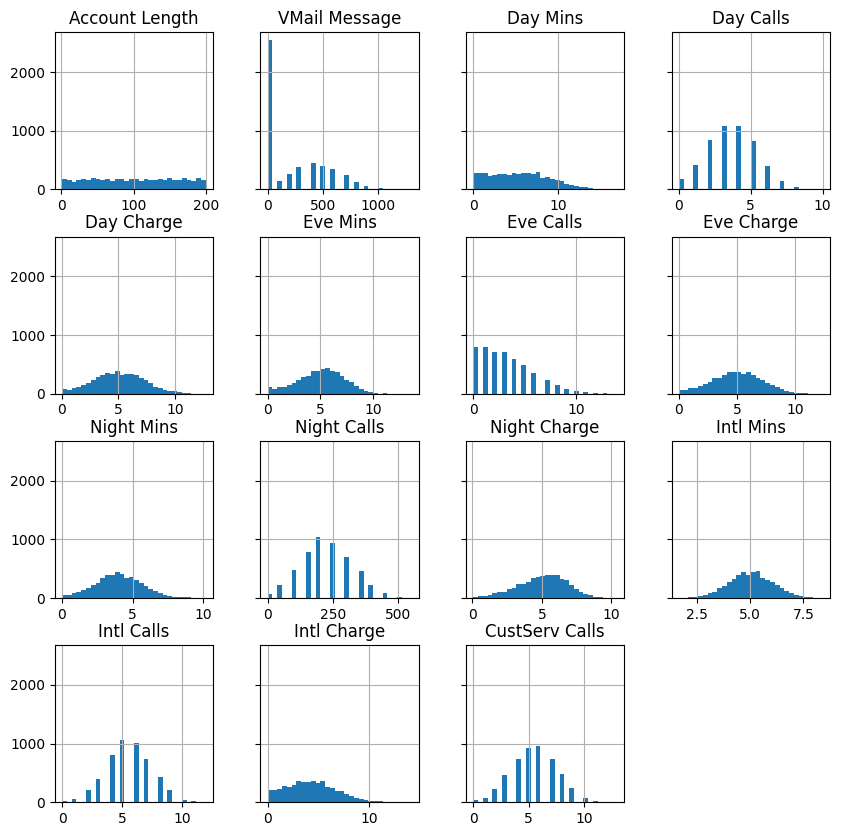

In [14]:
# some manual breakouts
# Frequency tables for each categorical feature
for column in df.select_dtypes(include=["string"]).columns:
    display(
        pd.crosstab(index=df[column], columns="% observations", normalize="columns")
    )

# Histograms for each numeric features
display(df.describe())

hist = df.hist(bins=30, sharey=True, figsize=(10, 10))

In [15]:
# data looks relatively evenly distributed
# note many VMail with zero messages

In [16]:
display(df.corr(numeric_only=True).style.background_gradient(cmap="Reds"))

,Account Length,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls
Account Length,1.000000,-0.009030,-0.015878,0.011659,-0.007468,0.000213,0.026515,-0.012795,0.016400,-0.002383,-0.034925,0.017277,-0.003735,0.028285,-0.036721
VMail Message,-0.009030,1.000000,-0.143272,0.002762,-0.182712,-0.104667,-0.101240,-0.029212,0.061370,0.135042,-0.155475,-0.015162,0.131964,0.010120,0.068657
Day Mins,-0.015878,-0.143272,1.000000,-0.087598,0.667941,0.482641,-0.184939,0.766489,0.188190,-0.445212,0.570508,0.001988,0.236131,0.239331,-0.195322
Day Calls,0.011659,0.002762,-0.087598,1.000000,-0.222556,0.033903,0.185881,-0.052051,-0.085222,-0.083050,0.046641,-0.022548,-0.045671,-0.120064,-0.065518
Day Charge,-0.007468,-0.182712,0.667941,-0.222556,1.000000,0.574697,0.236626,0.371580,0.150700,-0.130722,0.374861,0.010294,0.119584,0.251748,-0.260945
Eve Mins,0.000213,-0.104667,0.482641,0.033903,0.574697,1.000000,-0.067123,0.269980,-0.090515,0.067315,0.317481,-0.015678,0.070456,0.448910,-0.167347
Eve Calls,0.026515,-0.101240,-0.184939,0.185881,0.236626,-0.067123,1.000000,-0.467814,0.221439,0.218149,-0.324936,-0.001593,-0.112062,0.017036,-0.433467
Eve Charge,-0.012795,-0.029212,0.766489,-0.052051,0.371580,0.269980,-0.467814,1.000000,0.184230,-0.454649,0.546137,-0.003569,0.164104,0.243936,-0.011019
Night Mins,0.016400,0.061370,0.188190,-0.085222,0.150700,-0.090515,0.221439,0.184230,1.000000,-0.223023,-0.140482,-0.012781,0.038831,0.271179,-0.332802
Night Calls,-0.002383,0.135042,-0.445212,-0.083050,-0.130722,0.067315,0.218149,-0.454649,-0.223023,1.000000,-0.390333,-0.009821,0.181237,-0.155736,0.110211


In [17]:
# realculate the correlation matrix for numeric columns only
corr_matrix = df.corr(numeric_only=True)

# Define high correlation threshold
threshold = 0.55


# Function to apply color if correlation is high
def color_high_corr(val):
    color = "orange" if abs(val) > threshold else "none"
    return f"background-color: {color}"


# Apply the coloring function to the DataFrame
styled_corr_matrix = corr_matrix.style.applymap(color_high_corr)    # applymap in older module, when using python3.10

# Display the styled DataFrame
display(styled_corr_matrix)

,Account Length,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls
Account Length,1.000000,-0.009030,-0.015878,0.011659,-0.007468,0.000213,0.026515,-0.012795,0.016400,-0.002383,-0.034925,0.017277,-0.003735,0.028285,-0.036721
VMail Message,-0.009030,1.000000,-0.143272,0.002762,-0.182712,-0.104667,-0.101240,-0.029212,0.061370,0.135042,-0.155475,-0.015162,0.131964,0.010120,0.068657
Day Mins,-0.015878,-0.143272,1.000000,-0.087598,0.667941,0.482641,-0.184939,0.766489,0.188190,-0.445212,0.570508,0.001988,0.236131,0.239331,-0.195322
Day Calls,0.011659,0.002762,-0.087598,1.000000,-0.222556,0.033903,0.185881,-0.052051,-0.085222,-0.083050,0.046641,-0.022548,-0.045671,-0.120064,-0.065518
Day Charge,-0.007468,-0.182712,0.667941,-0.222556,1.000000,0.574697,0.236626,0.371580,0.150700,-0.130722,0.374861,0.010294,0.119584,0.251748,-0.260945
Eve Mins,0.000213,-0.104667,0.482641,0.033903,0.574697,1.000000,-0.067123,0.269980,-0.090515,0.067315,0.317481,-0.015678,0.070456,0.448910,-0.167347
Eve Calls,0.026515,-0.101240,-0.184939,0.185881,0.236626,-0.067123,1.000000,-0.467814,0.221439,0.218149,-0.324936,-0.001593,-0.112062,0.017036,-0.433467
Eve Charge,-0.012795,-0.029212,0.766489,-0.052051,0.371580,0.269980,-0.467814,1.000000,0.184230,-0.454649,0.546137,-0.003569,0.164104,0.243936,-0.011019
Night Mins,0.016400,0.061370,0.188190,-0.085222,0.150700,-0.090515,0.221439,0.184230,1.000000,-0.223023,-0.140482,-0.012781,0.038831,0.271179,-0.332802
Night Calls,-0.002383,0.135042,-0.445212,-0.083050,-0.130722,0.067315,0.218149,-0.454649,-0.223023,1.000000,-0.390333,-0.009821,0.181237,-0.155736,0.110211


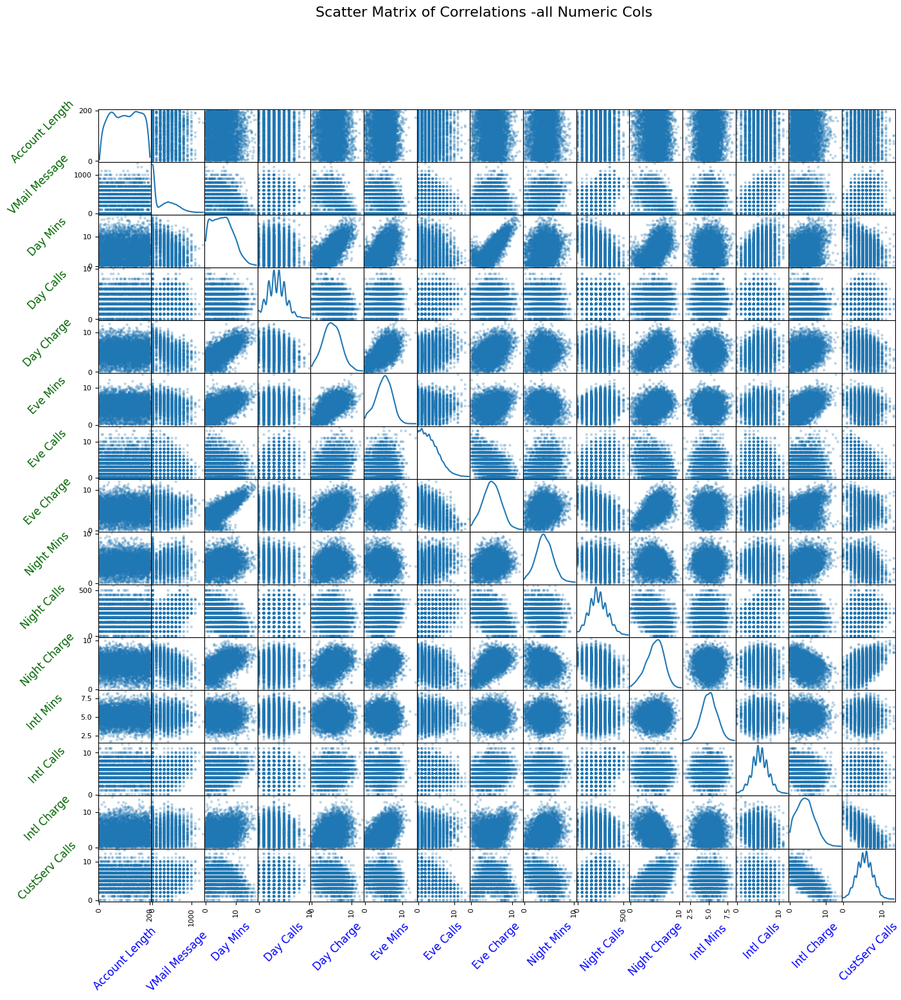

In [18]:
scatter_matrix_fig = pd.plotting.scatter_matrix(df, figsize=(16, 16), alpha=0.3, diagonal='kde', grid=True)

# fix label rotation for readability
for ax in scatter_matrix_fig.ravel():
    ax.set_xlabel(ax.get_xlabel(), fontsize=12, rotation=45)
    ax.set_ylabel(ax.get_ylabel(), fontsize=12, rotation=45, labelpad=35)
    ax.xaxis.label.set_color('blue')  # Set x axis labels to blue
    ax.yaxis.label.set_color('darkgreen')  # Set y axis labels to green

plt.suptitle("Scatter Matrix of Correlations -all Numeric Cols", fontsize=16)
plt.show()

In [19]:
# looks like there are high correlation between the "Day Charge" "Eve Charge" and "Night Charge" columns vs. Day Mins -- so let's drop the Charge columns, since they will be some scalar value * some num of minutes

df = df.drop(labels=["Day Charge", "Eve Charge", "Night Charge"], axis=1)

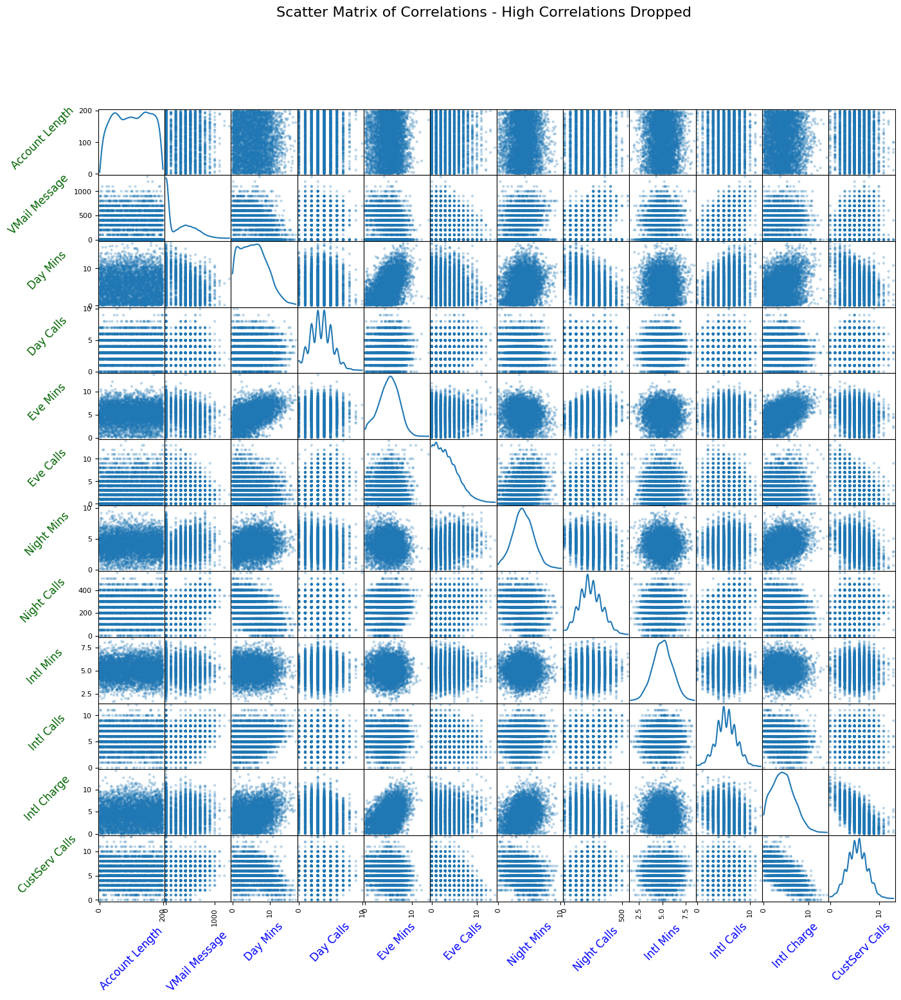

In [20]:
# let's graph this
scatter_matrix_fig = pd.plotting.scatter_matrix(df, figsize=(16, 16), alpha=0.3, diagonal='kde', grid=True)

# fix label rotation for readability
for ax in scatter_matrix_fig.ravel():
    ax.set_xlabel(ax.get_xlabel(), fontsize=12, rotation=45)
    ax.set_ylabel(ax.get_ylabel(), fontsize=12, rotation=45, labelpad=35)
    ax.xaxis.label.set_color('blue')  # Set x axis labels to blue
    ax.yaxis.label.set_color('darkgreen')  # Set y axis labels to green

plt.suptitle("Scatter Matrix of Correlations - High Correlations Dropped", fontsize=16)
plt.show()

# Start modeling

In [21]:
# get dummy values for category/string columns
model_data = pd.get_dummies(df)
model_data = pd.concat(
    [
        model_data["Churn?_True"],
        model_data.drop(["Churn?_False", "Churn?_True"], axis=1),
    ],
    axis=1,
)

# move data to GPU
model_data = cudf.DataFrame.from_pandas(model_data)

In [22]:
# modify this code to work with cudf - since 'numpy.split' not implmented with cudf
"""train_data, validation_data, test_data = np.split(
    model_data.sample(frac=1, random_state=1729),
    [int(0.7 * len(model_data)), int(0.9 * len(model_data))],
)

train_data.to_csv("./data/train.csv", header=False, index=False)
validation_data.to_csv("./data/validation.csv", header=False, index=False)
"""

# Shuffle the DataFrame
model_data = model_data.sample(frac=1, random_state=1729)

# Calculate split indices
train_end = int(0.7 * len(model_data))
validation_end = int(0.9 * len(model_data))

# Split the DataFrame
train_data = model_data.iloc[:train_end]
validation_data = model_data.iloc[train_end:validation_end]
test_data = model_data.iloc[validation_end:]

# Save to CSV files
train_data.to_csv("./data/train.csv", index=False)
validation_data.to_csv("./data/validation.csv", index=False)
test_data.to_csv("./data/test.csv", index=False)

In [23]:
# Umap visualization
# Create the mapper
mapper = umap.UMAP()

embedding = mapper.fit_transform(train_data.to_numpy())   # move this back to cpu memory temporarily for this visualization

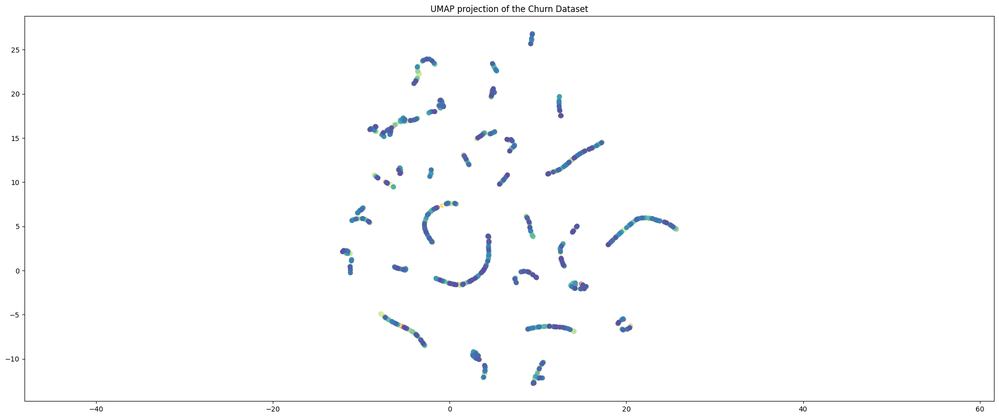

In [24]:
# scatter plot with a colormap
plt.figure(figsize=(25, 10))
plt.gca().set_aspect("equal", "datalim")
plt.title("UMAP projection of the Churn Dataset", fontsize=12)

# The third argument can be any array of the same length as the embedding data
plt.scatter(embedding[:, 0], embedding[:, 1], c=range(len(embedding)), cmap="Spectral")
plt.show()

In [25]:
# interesting, the data has clear clusters -- some are long ranges / curves -- long mostly purple/green lines
# and there are also some very tight clusers
# also single outliers - dark purple dots alone

# Lazypredict - let's see what the quick and dirty results look like

In [26]:
# using lazypredict lib
# link to our project data -- be sure to use `model_data` that has been converted to numeric, not the original df
X = model_data.drop(["Churn?_True"], axis=1)   # model data already on gpu per above
Y = model_data[
    "Churn?_True"
]  # this column contains our targets - did the user churn or not

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2)

clf_lazy = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)
clf_models, clf_predictions = clf_lazy.fit(X_train.to_numpy(), X_test.to_numpy(), y_train.to_numpy(), y_test.to_numpy())    # again push this back to numpy/cpu so we don't have to refactor everything

clf_models

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:07<00:00,  4.08it/s]

[LightGBM] [Info] Number of positive: 2005, number of negative: 1995
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1824
[LightGBM] [Info] Number of data points in the train set: 4000, number of used features: 100
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.501250 -> initscore=0.005000
[LightGBM] [Info] Start training from score 0.005000


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
XGBClassifier,0.94,0.93,0.93,0.93,0.25
LGBMClassifier,0.93,0.93,0.93,0.93,0.21
BaggingClassifier,0.91,0.91,0.91,0.91,0.35
RandomForestClassifier,0.91,0.91,0.91,0.91,0.62
ExtraTreesClassifier,0.90,0.90,0.90,0.90,0.52
DecisionTreeClassifier,0.88,0.88,0.88,0.88,0.08
LogisticRegression,0.87,0.87,0.87,0.87,0.07
LinearSVC,0.87,0.87,0.87,0.87,0.66
CalibratedClassifierCV,0.87,0.87,0.87,0.87,0.37


In [27]:
# looks like we should be able to hit ~0.94 with XGBoost -- why higher than other notebook?  older library, also on cpu, same data?

In [28]:
import xgboost as xgb
from cuml import train_test_split as cuml_train_test_split

In [29]:
# NOTE - may not need this anymore

# reset on model data
model_data = pd.get_dummies(df)
model_data = pd.concat(
    [
        model_data["Churn?_True"],
        model_data.drop(["Churn?_False", "Churn?_True"], axis=1),
    ],
    axis=1,
)


X = model_data.drop(["Churn?_True"], axis=1)   # model data already on gpu per above
Y = model_data[
    "Churn?_True"
]  # this column contains our targets - did the user churn or not

# move data to GPU
# model_data = cudf.DataFrame.from_pandas(model_data)
X = cudf.DataFrame.from_pandas(X)
Y = cudf.Series.from_pandas(Y)

X_train, X_test, y_train, y_test = cuml_train_test_split(X, Y, test_size=0.2)


In [30]:
# train 
xgb_clf = XGBClassifier(
    colsample_bytree=1,
    eta=0.5, 
    learning_rate=0.05,
    max_depth=10,
    missing=1,
    n_estimators=400,
    random_state=42,
    seed=2,
    subsample=0.8,
    tree_method='gpu_hist',  
    verbosity=2   
)  # edit `missing=None ==> missing=1`

xgb_clf.fit(X_train, y_train.astype(int))

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device=None, early_stopping_rounds=None, enable_categorical=False,
              eta=0.5, eval_metric=None, feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.05, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=10, max_leaves=None,
              min_child_weight=None, missing=1, monotone_constraints=None,
              multi_strategy=None, n_estimators=400, n_jobs=None,
              num_parallel_tree=None, ...)

In [31]:
import xgboost as xgb
import cudf
from sklearn.metrics import accuracy_score

# Ensure y_test is an integer type, as expected by the classifier
y_test_int = y_test.astype(int)

# Get predictions directly using cuDF structures
y_pred = xgb_clf.predict(X_test)

# convert to NumPy for compatibility with scikit-learn metrics - in cpu, but quick
accuracy = accuracy_score(y_test_int.to_numpy(), y_pred)

print(f"Accuracy: {accuracy}")

Accuracy: 0.941


In [32]:
# OKAY - 94% on first pass, let's try some hyperparameter optimization to see what else we can do

In [33]:
# of course - some libraries don't work with GPU, e.g. scikit-learn GridsearchCV, so we'll refactor to dask which can use GPU
from dask_cuda import LocalCUDACluster
from dask.distributed import Client


In [34]:
# Create a Dask CUDA cluster
cluster = LocalCUDACluster()
client = Client(cluster)
client


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 1
Total threads: 1,Total memory: 58.86 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:35971,Workers: 1
Dashboard: http://127.0.0.1:8787/status,Total threads: 1
Started: Just now,Total memory: 58.86 GiB
Comm: tcp://127.0.0.1:39441,Total threads: 1
Dashboard: http://127.0.0.1:43445/status,Memory: 58.86 GiB
Nanny: tcp://127.0.0.1:42513,
